In [1]:
from imports import *

Acquiring from SQL database


<Figure size 432x288 with 0 Axes>

<h1 style = "border:10px; border-style:groove; border-color:maroon; padding: 1em; text-align: center;" >  California Dreamin' (of Beating the Zestimate...Redux) <br> <img src= "cali.web.gif" width = "700" align = "center"> </h1>

# Project Planning

- Acquire data from the Codeup Database and store the process as a function for replication. Save the function in a wrangle.py file to import into the Final Report Notebook.

- View data to gain understanding of the dataset and to create the readme.
    
- Create README.md with data dictionary, project and business goals, documentation of the initial hypotheses.
    
- Clean and prepare data for the first iteration through the data pipeline. Store this as a function to automate the process, store the function in the wrangle.py module, and prepare data in Final Report Notebook by importing and using the funtion.

- Clearly define at least two hypotheses, set an alpha, run the statistical tests needed, reject or fail to reject the Null Hypothesis, and document findings and takeaways.
   
- Establish a baseline accuracy and document well.

- Train four different regression models.
    
- Evaluate models on train and validate datasets.
    
- Choose the model with that performs the best and evaluate that single model on the test dataset.    

- Document executive summary, conclusions, takeaways, and next steps in the Final Report Notebook.

- Upload README.md, Data Dictionary, wrangle.py, Project Scratch Notebook, Final Report Notebook

<hr style="border-top: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px"></hr>

# Executive Summary

- The regression models had similar performance, with the GLM Model using Tweedie Regression resulting in the lowest overall Root Mean Squared Error.

    - The features included in this model:
    
        - Area
        - Age 
        - Bedrooms/Bathrooms
   
- Using clustering for feature engineering and feature development proved inconclusive. 

- The model outperformed the baseline accuracy.

- Several insights and statistical testing during the exploratory data analysis revealed that analysis by absolute log error is beneficial for gaining insights into which counties and features produce the most log error volatility.

<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Data Aquisition </hr>

In [2]:
#acquire data
train, validate, test, df = zc_wrangle.wrangled_zillow()

#acquire split data
train_VC, train_LA, train_OC, validate_VC, validate_LA, validate_OC, test_VC, test_LA, test_OC = zc_wrangle.split_county_tvt(train, validate, test) 

#acquire scaled data
scaler, train_scaled, validate_scaled, test_scaled = zc_wrangle.scale_data(train, validate, test, return_scaler = True)

#acquire scaled split data
scaler, train_scaled_VC, train_scaled_LA, train_scaled_OC, validate_scaled_VC, validate_scaled_LA, validate_scaled_OC, test_scaled_VC, test_scaled_LA, test_scaled_OC = zc_wrangle.scale_split_data(train, validate, test, return_scaler = True)

train.head()

Acquiring from SQL database


,propertylandusetypeid,bathrooms,bedrooms,area,county,latitude,longitude,lot_size,census_tract,region_id_city,...,lot_dollar_sqft_bin,bath_bed_ratio,cola,logerror_bins,bed_and_bath,tax_value_binned,tax_value_encoded,pw_build,pw_build_encoded,abs_logerror
48107,261.0,2.0,4.0,1461.0,LA,34.102910,-117.886037,7067.0,60.374059,24245,...,0.3,0.500000,0,"(0.05, 0.2]",6.0,Med,1,True,1,0.060393
67544,261.0,2.0,3.0,1096.0,OC,33.854496,-117.981598,2980.0,60.590868,16764,...,0.3,0.666667,0,"(-0.05, 0.05]",5.0,Med,1,True,1,0.040962
53781,261.0,2.0,3.0,1554.0,LA,33.913990,-118.320611,5300.0,60.376026,45398,...,0.3,0.666667,0,"(-0.05, 0.05]",5.0,Low,0,True,1,0.031277
60586,261.0,2.0,3.0,1451.0,LA,34.686089,-118.189622,5868.0,60.379010,5534,...,0.2,0.666667,0,"(-0.05, 0.05]",5.0,Med,1,True,1,0.021057
31011,261.0,2.0,3.0,1702.0,LA,34.022588,-117.815344,7498.0,60.374033,24384,...,0.3,0.666667,0,"(-0.05, 0.05]",5.0,High,2,True,1,0.010155


<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Data Preparation </hr>

#### How it started:

- The original dataframe was ~ 77,381 rows and 67 columns

    - Redundant and unnecessary columns and columns missing entire rows were dropped.
    - Outliers were handled using IQR.
    - Features were added.
    - Some nulls were imputed.
    
#### How it's going:

- In the end, the dataframe before the train, test, and split is 39687 rows and 45 columns.

<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Exploratory Analysis/Statistical Testing <br></hr>

#### Initial Questions:

   - Where are these log errors taking place? 
   - Does Orange County have a higher log error than average?
   - Is there a linear relationship between log error and home value?
   - Is there a relationship between log error and area?
   - Is the log error in LA significantly lower than the log error in Orange County?
   - Is there a linear relationship between log error and year built?

In [3]:
visuals_zc.get_map()

#### Takeaways

- Visually, log error appears all over the map.
- In some areas, such as areas along the coast and in the mountainous areas, there are a few more homes with a higher log error.
    - Several homes inland also have variation in home price.
    

<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### What are some factors that may be driving log error?

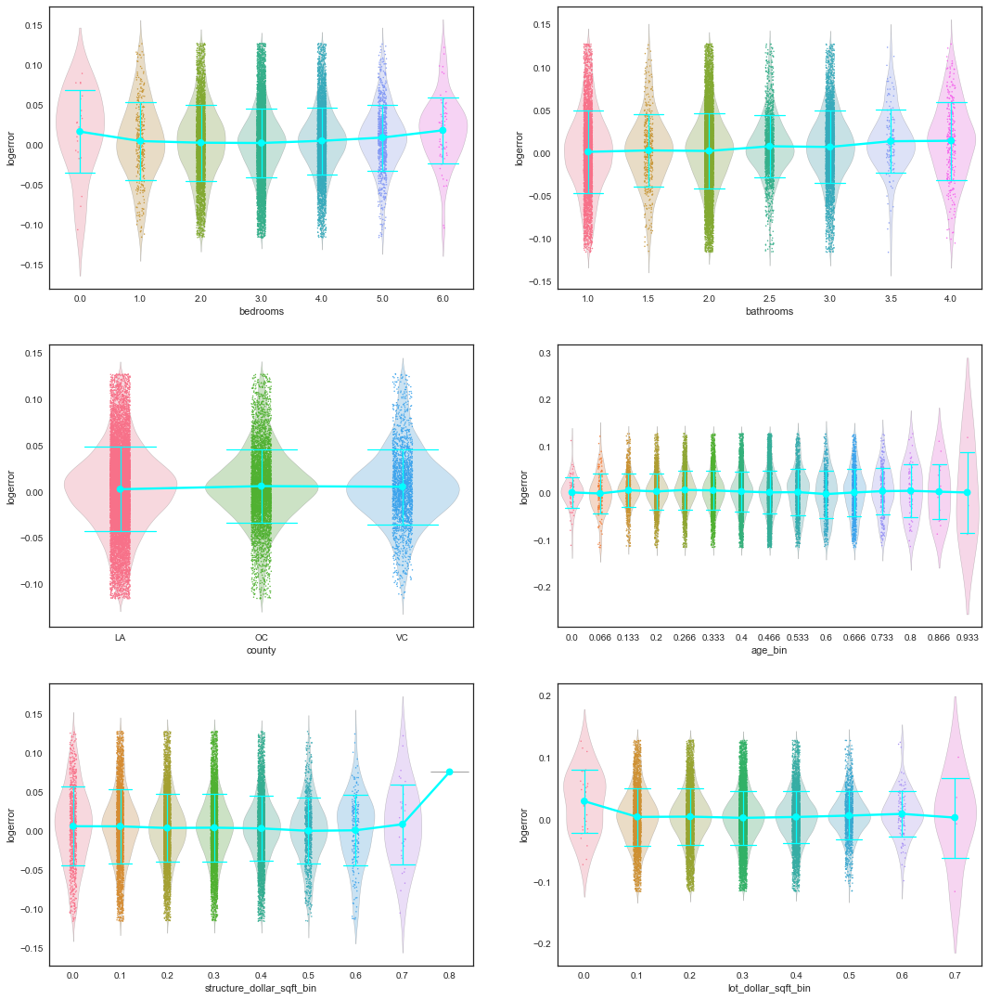

In [4]:
visuals_zc.explore_1()

#### Takeaways:

*Answer:* Bedroom count, the age of a home, structure_dollar_sqft, and lot_dollar_sqft_bin stand out most prominently.

- Looking at this visualization, few things stand out definitively. It appears that homes with zero or six bedrooms seem to have more varied log errors. Older homes also seem to be more prone to having an undesired log error. Orange county appears to be marginally ahead in log errors, additional statistical tests will be performed.

<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Is the log error of Orange County significantly higher than the mean log error of Ventura, LA, and Orange counties?

One Sample T-Test

$\alpha$ = .05

$𝐻_{0}$: Orange County mean log error is <= than the combined mean log errors of Ventura, Los Angeles, and Orange counties.

𝐻𝑎: Orange County mean log error is > than the combined mean log errors of Ventura, Los Angeles, and Orange counties.

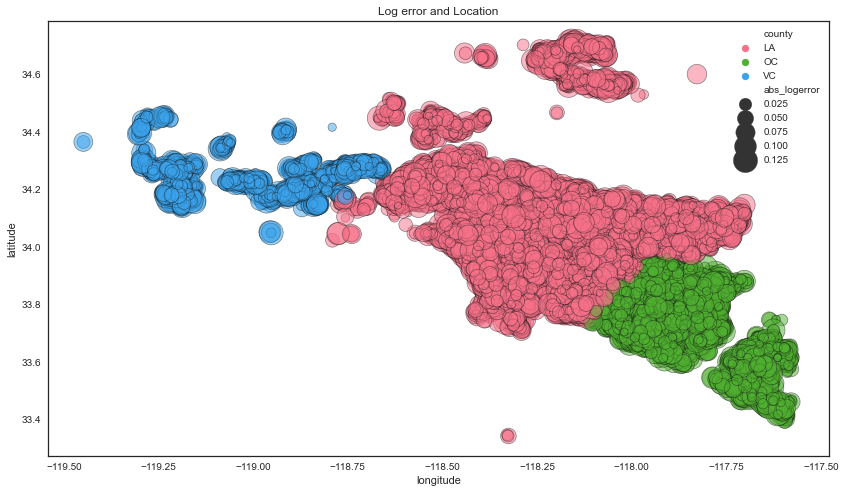

In [5]:
visuals_zc.explore_2()

In [6]:
#set alpha
α = 0.05

#get sample
oc_sample = train[train.county == 'OC'].logerror

#get mean
overall_mean = train.logerror.mean()

#perform test
t, p = stats.ttest_1samp(oc_sample, overall_mean)

#print p-value
print(f'P Value: {p/2:.3f}')

#evaluate if mean of OC homes is significantly higher than all homes, is p/2 < a and t > 0?
if p/2 < α and t > 0:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

P Value: 0.000
Reject the null hypothesis.


#### Takeaways:
*Answer:* The mean log error of Orange County is higher than the combined means of LA, Ventura, and Orange Counties.

- Although the statistical tests shows that Orange county has a higher log error, this may not be an unreasonable occurrence considering home prices in the area. 
- Looking at the visualization, and seeing that LA county has the largest and most log error prone county, by absolute standards, looking at log error alone may not produce the most accurate analysis.

<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Are log errors more drastic during certain times of the year?

In [7]:
visuals_zc.date_viz()

Loading BokehJS ...

#### Takeaways:

*Answer:* There is a relationship between log error and the transaction date.

- This visualization also used the absolute value of log error, and spring and summer transactions tend to produce a notable fluctuation in log error.
- The largest spike in absolute log error occurs in Orange County.

<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Is there a linear relationship between log error and home value?

Spearmans's R

$\alpha$ = .05

$𝐻_{0}$: There is no linear relationship between log error and home value.

𝐻𝑎: There is a linear relationship between log error and home value.

In [8]:
#tax_value not normally distributed, so use Spearman's
#set alpha
α = .05

#perform test
r, p = spearmanr(train.tax_value, train.logerror)

#evaluate coefficient and p-value
print(f'Correlation Coefficient: {r:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Correlation Coefficient: 0.015
P-value: 0.022
Reject the null hypothesis.


*Answer:* There is a relationship between log error and the homes value.

<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Is there a linear relationship between log error and area?

Spearmans's R

$\alpha$ = .05

$𝐻_{0}$: There is no linear relationship between log error and area.

𝐻𝑎: There is a linear relationship between log error and area.

In [9]:
#area not normally distributed, so use Spearman's
#set alpha
α = .05

#perform test
r, p = spearmanr(train.area, train.logerror)

#evaluate coefficient and p-value
print(f'Correlation Coefficient: {r:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Correlation Coefficient: 0.064
P-value: 0.000
Reject the null hypothesis.


*Answer:* There is a relationship between log error and area.

<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Is the log error in LA significantly lower than the log error in Orange County?

Two Sample T-Test

$\alpha$ = .05

$𝐻_{0}$: LA County mean log error is >= than the mean log error of Orange County.

𝐻𝑎: LA County mean log error is < than the mean log error of Orange County.

In [10]:
#test for equal variance 
#H0 is that the variances are equal
#Ha is that the variances are not equal
# if p > .05, variances are not significantly different and set argument to equal_var = True
#if p < .05, variances are significantly different and set argument to equal_var = False
#Levene test on two groups


#set alpha
α = 0.05

#perform test to determine variance
f, p = stats.levene(train[train.LA == 1].logerror,
             train[train.Orange == 1].logerror)

#evaluate coefficient and p-value
print(f'Levene\'s F-statistic: {f:.3f}\nP-value: {p:.3f}')


#evaluate if 
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Levene's F-statistic: 158.872
P-value: 0.000
Reject the null hypothesis.


*Answer:* The log error in LA is lower than the log error in Orange County.

In [11]:
#set alpha
α = 0.05

#perform test
t, p = stats.ttest_ind(train[train.LA == 1].logerror, train[train.Orange == 1].logerror, equal_var = False)

#print p-value
print(f'P Value: {p/2:.3f}')

#evaluate if mean of LA log error is significantly less than log error of Orange Co, is p/2 < a and t < 0?
if p/2 < α and t < 0:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

P Value: 0.000
Reject the null hypothesis.


<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Is there a linear relationship between log error and the homes age?

Spearmans's R

$\alpha$ = .05

$𝐻_{0}$: There is no linear relationship between log error and the homes age.

𝐻𝑎: There is a linear relationship between log error and the homes age.

In [12]:
visuals_zc.age_viz()

Loading BokehJS ...

In [13]:
#year_built not normally distributed, so use Spearman's
#set alpha
α = .05

#perform test
r, p = spearmanr(train.age, train.logerror)

#evaluate coefficient and p-value
print(f'Correlation Coefficient: {r:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Correlation Coefficient: -0.035
P-value: 0.000
Reject the null hypothesis.


<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

#### Takeaways:

*Answer:* There is a relationship between log error and the homes age.

- Newer homes have more variation in log error than expected.
- Slightly seasoned homes, those between 20 and 40 years old in all counties seem the most steady for variance in log error.
- Homes older than 60 years old have the most volatile swings in log error.

<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Exploration Summary </hr>


-  The target variable and features chosen for the exploratory statistical analysis section have fuzzy, unclear relationships. 
- The visualizations provided some context for why looking at log error alone fails to communicate a complete story. 
- While Orange County may have the highest log errors, the sheer vastness and complexity of LA suggests that LA may be more prone to log errors.
- Age of the home plays a key role in log error fluctuations.
- Spring and Summer, when home buying is traditionally the busiest, also contributes to more opportunities for fluctuations in log error.

<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Clustering Exploration Summary</hr>


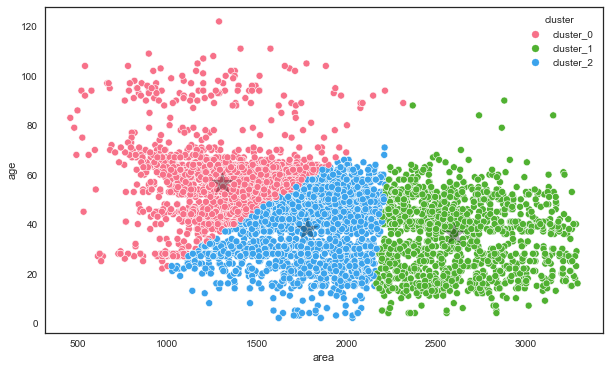

In [14]:
X = train_OC[['area', 'age']]

train_OC, X_scaled, scaler, kmeans , centroids = visuals_zc.create_clusters(train_OC, X, 3)


centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

visuals_zc.create_scatter('area', 'age', train_OC, kmeans, X_scaled, scaler)

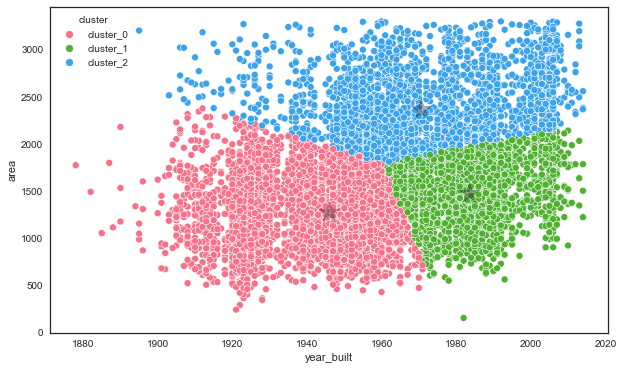

In [15]:
X = train_LA[['year_built', 'area']]

train_LA, X_scaled, scaler, kmeans, centroids = visuals_zc.create_clusters(train_LA, X, 3)

centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

visuals_zc.create_scatter('year_built', 'area', train_LA, kmeans, X_scaled, scaler)

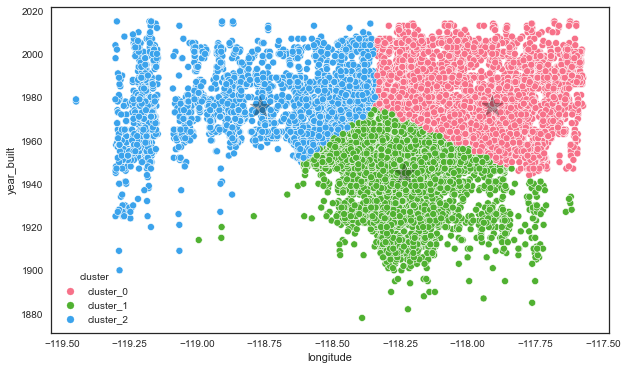

In [16]:
X = train[['longitude', 'year_built']]

train, X_scaled, scaler, kmeans, centroids = visuals_zc.create_clusters(train, X, 3)

centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

visuals_zc.create_scatter('longitude', 'year_built', train, kmeans, X_scaled, scaler)

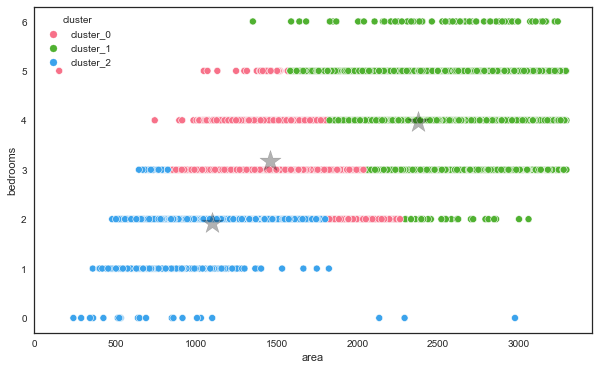

In [17]:
X = train[['area', 'bedrooms']]

train, X_scaled, scaler, kmeans, centroids = visuals_zc.create_clusters(train, X, 3)

centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

visuals_zc.create_scatter('area', 'bedrooms', train, kmeans, X_scaled, scaler)

#### Takeaways:

 - Clustering provided some interesting insight into features that may prove predictive for modeling.
 - Simple clusters were best to adequately portray the result.

<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Modeling and Evaluation </hr>

#### Baseline

In [18]:
#get baseline, baseline is mean/median of dependent variable yhat_baseline == baseline

baseline = np.sqrt(train.logerror.mean())

print(f'RMSE Baseline is: ',  f'{baseline:.5f}')

RMSE Baseline is:  0.06452


### Multilinear Regression

In [19]:
#create X's on scaled data
X_train = train_scaled[['bedrooms', 'area']]
X_validate = validate_scaled[['bedrooms', 'area']]
X_test = test_scaled[['bedrooms', 'area']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].mean()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = round(y_validate['logerror'].mean(), 2)

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#calculate percent change
percent_change_train = ((baseline - RMSE_train ) / baseline) * 100 
percent_change_validate = ((baseline - RMSE_validate) / baseline) * 100

#print results
print("RMSE for Multiliniear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')
print('~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
print("Percent Change for Multilinear Regression Model\nTraining/In-Sample: ", f'{percent_change_train:.2f}%', 
      "\nPercent Change for Validation/Out-of-Sample: ", f'{percent_change_validate:.2f}%')

RMSE for Multiliniear Regression Model
Training/In-Sample:  0.04386 
Validation/Out-of-Sample:  0.04380
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Percent Change for Multilinear Regression Model
Training/In-Sample:  32.03% 
Percent Change for Validation/Out-of-Sample:  32.11%


<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### LASSO + LARS

In [20]:
#create X's on scaled data

X_train = train_scaled[['bedrooms', 'area']]
X_validate = validate_scaled[['bedrooms', 'area']]
X_test = test_scaled[['bedrooms', 'area']]

# create y's on unscaled data

y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]


#create model
lars = LassoLars(alpha = 1)

lars.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = lars.predict(X_train)

#make predictions on validate(yhat)
y_validate_pred = lars.predict(X_validate)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

percent_change_train = ((baseline - RMSE_train ) / baseline) * 100 

percent_change_validate = ((baseline - RMSE_validate) / baseline) * 100

#print results

print("RMSE for Lasso + Lars\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')
print('~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
print("Percent Change for Lasso + Lars\nTraining/In-Sample: ", f'{percent_change_train:.2f}%', 
      "\nPercent Change for Validation/Out-of-Sample: ", f'{percent_change_validate:.2f}%')

RMSE for Lasso + Lars
Training/In-Sample:  0.04387 
Validation/Out-of-Sample:  0.04388
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Percent Change for Lasso + Lars
Training/In-Sample:  32.01% 
Percent Change for Validation/Out-of-Sample:  31.99%


<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Polynomial Regression

In [21]:
 #create X's on scaled data

X_train = train_scaled[['bedrooms', 'area']]
X_validate = validate_scaled[['bedrooms', 'area']]
X_test = test_scaled[['bedrooms', 'area']]

# create y's on unscaled data

y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]


#create converter
pf = PolynomialFeatures(degree = 3)


#fit and transform  on x_scaled
X_train_degree3 = pf.fit_transform(X_train)


#transform X_validate & X_test
X_validate_degree3 = pf.transform(X_validate)

X_test_degree3 = pf.transform(X_test)


#make lr model

lr_p = LinearRegression(normalize = True)

#fit to converted train
lr_p.fit(X_train_degree3, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr_p.predict(X_train_degree3), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr_p.predict(X_validate_degree3), 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#calculate percent change
percent_change_train = ((baseline - RMSE_train ) / baseline) * 100 
percent_change_validate = ((baseline - RMSE_validate) / baseline) * 100

#print results
print("RMSE for Polynomial Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')
print('~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
print("Percent Change for Polynomial Regression\nTraining/In-Sample: ", f'{percent_change_train:.2f}%', 
      "\nPercent Change for Validation/Out-of-Sample: ", f'{percent_change_validate:.2f}%')

RMSE for Polynomial Regression Model
Training/In-Sample:  0.04384 
Validation/Out-of-Sample:  0.04377
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Percent Change for Polynomial Regression
Training/In-Sample:  32.06% 
Percent Change for Validation/Out-of-Sample:  32.16%


<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

### Tweedie Regression

In [22]:
baseline = np.sqrt(train.abs_logerror.mean())

print(f'RMSE Baseline is: ',  f'{baseline:.5f}')

RMSE Baseline is:  0.18391


In [23]:
#create X's on scaled data

X_train = train_scaled[['bed_and_bath','area', 'age']]
X_validate = validate_scaled[['bed_and_bath', 'area', 'age']]
X_test = test_scaled[['bed_and_bath', 'area', 'age']]

# create y's on unscaled data
# unable to use negative values in this model, use abs_logerror
y_train = train[['abs_logerror']] 
y_validate = validate[['abs_logerror']]
y_test = test[['abs_logerror']]


#create model
glm = TweedieRegressor(power = 1, alpha = 0)

#fit to train
glm.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(glm.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(glm.predict(X_validate), 2)

#make predictions on validate(yhat)
y_test_pred = np.round(glm.predict(X_test), 2)

#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['abs_logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['abs_logerror']], y_validate_pred))


RMSE_test = np.sqrt(mean_squared_error(y_test[['abs_logerror']], y_test_pred))

#calculate percent change
percent_change_train = ((baseline - RMSE_train ) / baseline) * 100 
percent_change_validate = ((baseline - RMSE_validate) / baseline) * 100

#print results
print("RMSE for GLM using Tweedie\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')
print('~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
print("Percent Change for GLM using Tweedie\nTraining/In-Sample: ", f'{percent_change_train:.2f}%', 
      "\nOut-of-Sample: ", f'{percent_change_validate:.2f}%')

RMSE for GLM using Tweedie
Training/In-Sample:  0.02812 
Validation/Out-of-Sample:  0.02838
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Percent Change for GLM using Tweedie
Training/In-Sample:  84.71% 
Out-of-Sample:  84.57%


<hr style="border-top: 5px groove blanchedalmond; margin-top: 1px; margin-bottom: 1px"></hr>

<h1 style="border-bottom: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Modeling Evaluation on Test</hr>

In [24]:
#create X's on scaled data

X_train = train_scaled[['bed_and_bath','area', 'age']]
X_validate = validate_scaled[['bed_and_bath', 'area', 'age']]
X_test = test_scaled[['bed_and_bath', 'area', 'age']]

# create y's on unscaled data
# unable to use negative values in this model, use abs_logerror
y_train = train[['abs_logerror']] 
y_validate = validate[['abs_logerror']]
y_test = test[['abs_logerror']]


#create model
glm = TweedieRegressor(power = 1, alpha = 0)

#fit to train
glm.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(glm.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(glm.predict(X_validate), 2)

#make predictions on validate(yhat)
y_test_pred = np.round(glm.predict(X_test), 2)

#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['abs_logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['abs_logerror']], y_validate_pred))


RMSE_test = np.sqrt(mean_squared_error(y_test[['abs_logerror']], y_test_pred))

#calculate percent change
percent_change_train = ((baseline - RMSE_train ) / baseline) * 100 
percent_change_validate = ((baseline - RMSE_validate) / baseline) * 100
percent_change_test = ((baseline - RMSE_validate) / baseline) * 100

#print results
print("RMSE for GLM using Tweedie\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')
print('~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
print("Percent Change for GLM using Tweedie\nTraining/In-Sample: ", f'{percent_change_train:.2f}%', 
      "\nOut-of-Sample: ", f'{percent_change_test:.2f}%')

RMSE for GLM using Tweedie
Training/In-Sample:  0.02812 
Validation/Out-of-Sample:  0.02838
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Percent Change for GLM using Tweedie
Training/In-Sample:  84.71% 
Out-of-Sample:  84.57%


<hr style="border-top: 10px groove lightsteelblue; margin-top: 1px; margin-bottom: 1px"></hr>

In [25]:
visuals_zc.viz_pca()

<h1 style ="border-bottom: 10px groove blanchedalmond; margin-top: 1px; margin-bottom: 2px; text-align: left;"> Recommendations </hr>

- Take efforts to reduce information gaps that may lead to increased instances of missed predictions/more frequent and significant drivers of log error.
- Increased home sales in the spring and summer impact absolute log error, develop a seasonally adjusted metric that could be applied to sales that occur during peak home-buying seasons.

<h1 style="border-bottom: 10px groove maroon; margin-top: 1px; margin-bottom: 2px; text-align: left;">
Conclusion and Next Steps </hr>


The log error proved quite sensitive and a bit less intuitive to predict than other target features. Using features that seemed to show correlation often resulted in a lackluster model. The data provided was noisy and missing a several key pieces of data that may have been helpful in creating a better predictive model. Given more time, I would like to use geospatial files and public information to create geographic boundaries for neighborhoods, school districts, and natural features that may provide better predictive insight and reduce log error in future model deployments.